# **EDA and Correlation study Notebook**

## Objectives

* To cary out an EDA using Pandas profiling, to understand the dataset and try to validate some hypothesis. 
* Perform a correlation study in order to answer business requirement 1:

   -  The client is interested in identifying the key factors that contribute to patients readmissions. 

## Inputs

* outputs/dataset/collection/HospitalReadmissions.csv 

## Outputs

* Generate code that answers business requirement 1 and can be used to build the Streamlit App.

---

# Change working directory

We need to change the working directory from its current folder to its parent folder
* We access the current directory with os.getcwd()

In [1]:
import os
current_dir = os.getcwd()
current_dir

'c:\\Users\\Andrias\\Desktop\\patient-readmission\\jupyter_notebooks'

We want to make the parent of the current directory the new current directory
* os.path.dirname() gets the parent directory
* os.chir() defines the new current directory

In [2]:
os.chdir(os.path.dirname(current_dir))
print("You set a new current directory")

You set a new current directory


Confirm the new current directory

In [6]:
current_dir = os.getcwd()
current_dir

'c:\\Users\\Andrias\\Desktop\\patient-readmission'

---

# Load the dataset

Load the dataset that was saved at the end of the previous notebook.

In [7]:
import pandas as pd

data_path = "outputs/datasets/collection/HospitalReadmissions.csv"

df = pd.read_csv(data_path)
df.head()

,age,time_in_hospital,n_lab_procedures,n_procedures,n_medications,n_outpatient,n_inpatient,n_emergency,medical_specialty,diag_1,diag_2,diag_3,glucose_test,A1Ctest,change,diabetes_med,readmitted
0,[70-80),8,72,1,18,2,0,0,Missing,Circulatory,Respiratory,Other,no,no,0,1,0
1,[70-80),3,34,2,13,0,0,0,Other,Other,Other,Other,no,no,0,1,0
2,[50-60),5,45,0,18,0,0,0,Missing,Circulatory,Circulatory,Circulatory,no,no,1,1,1
3,[70-80),2,36,0,12,1,0,0,Missing,Circulatory,Other,Diabetes,no,no,1,1,1
4,[60-70),1,42,0,7,0,0,0,InternalMedicine,Other,Circulatory,Respiratory,no,no,0,1,0


---

## Libraries needed for the Notebook

In [8]:
import os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import ppscore as pps
import warnings

from ydata_profiling import ProfileReport

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.pipeline import make_pipeline

warnings.filterwarnings('ignore')

sns.set_style("darkgrid")

target_var = "readmitted"


## Pandas Profiling

In order to better understand the dataset, data profiling is carried out using the ProfileReport class from the ydata_profiling library.

This will give an overview of the dataset and it's characteristics, analyse the features using statistical methods and investigate relationships between features

From the overview, we can see that there are no missing values or duplicated rows and there are 9 alerts.

* As we saw in the previous notebook the variable "medical_specialty" has no actual missing values, however nearly half of the rows are labelled "Missing", which potentially we may consider, later on, dropping this variable.
* The same applies to the variables "diag_1", "diag_2" and "diag_3". They don't have actual missing values, however, a small number of values are labelled 'Missing'. 
* In the alerts section we can see that "glucose_test" and "A1Ctest" are imbalanced. However, our target variable "readmitted" appears to be be relatively well balanced.
* Also the n_emergency is highly skewed and contains a lot of zeros, which will also need feature scaling and engineering. 
* Moving further down to the Correlations, we see the highest correlation between 2 variables, "change" and "diabetes_med" and we can see low to moderate correlation between out target variable, "readmitted", and the "n_inpatients" variable. This might indicate that we might struggle to find correlate features for our target variable. 
 

In [7]:
profile = ProfileReport(df, title="Pandas Profiling Report", explorative=True)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Analysis of Features

Before we assess the correlation levels between our target variable and the features, we will first analyse the dataset's features.

* First we will identify outliers and check the distribution of the numerical features, using visualization and statistical methods. 
* Then we will check the categorical features by plotting graphs. 

### Check for outliers

In [11]:
numerical_features = df.select_dtypes(include='number').drop(target_var, axis=1)

for col in numerical_features:
    fig = px.histogram(df, x=col, marginal="box", title=f"**{col}** Distribution", color=df[target_var])
    fig.show()
    print("\n")

The boxplots and histograms reveal tha the dataset contains a significant number of outliers, particularly in the columns "n_outpatient", "n_inpatient" and "n_emergency", and also that these variables are highly skewed.

Below, using the function **calc_outliers()** we calculate the skewness, kurtosis and variance of each numerical variable and then we count the number of outliers below Q1 and above Q3.

In [9]:
def calc_skew_kurtosis_variance(df, col):
    print(f"--{col}--\nSkewness: {df[col].skew().round(2)}\nKurtosis: {df[col].kurtosis().round(2)}\n"
            f"Variance: {df[col].var().round(2)}")
    
def calc_IQR(df, col):
    return df[col].quantile(q=0.75) - df[col].quantile(q=0.25)

def calc_outliers(df):
    for col in df.columns:
        IQR = calc_IQR(df, col)
        below_q1 = 0
        above_q3 = 0

        for obs in df[col]:
            if obs < (df[col].quantile(q=0.25) - 1.5*IQR):
                below_q1 += 1
            elif obs > (df[col].quantile(q=0.75) + 1.5*IQR):
                above_q3 += 1

        calc_skew_kurtosis_variance(df, col)
        print(f"There are {below_q1} outliers below Q1 - 1.5 * IQR")
        print(f"There are {above_q3} outliers above Q3 + 1.5 * IQR")
        print("\n")
        
calc_outliers(numerical_features)

--time_in_hospital--
Skewness: 1.11
Kurtosis: 0.8
Variance: 9.01
There are 0 outliers below Q1 - 1.5 * IQR
There are 580 outliers above Q3 + 1.5 * IQR


--n_lab_procedures--
Skewness: -0.24
Kurtosis: -0.3
Variance: 392.78
There are 0 outliers below Q1 - 1.5 * IQR
There are 33 outliers above Q3 + 1.5 * IQR


--n_procedures--
Skewness: 1.3
Kurtosis: 0.8
Variance: 2.94
There are 0 outliers below Q1 - 1.5 * IQR
There are 1227 outliers above Q3 + 1.5 * IQR


--n_medications--
Skewness: 1.32
Kurtosis: 3.48
Variance: 64.97
There are 0 outliers below Q1 - 1.5 * IQR
There are 844 outliers above Q3 + 1.5 * IQR


--n_outpatient--
Skewness: 7.3
Kurtosis: 95.93
Variance: 1.43
There are 0 outliers below Q1 - 1.5 * IQR
There are 4141 outliers above Q3 + 1.5 * IQR


--n_inpatient--
Skewness: 3.25
Kurtosis: 16.45
Variance: 1.39
There are 0 outliers below Q1 - 1.5 * IQR
There are 1628 outliers above Q3 + 1.5 * IQR


--n_emergency--
Skewness: 24.53
Kurtosis: 1310.59
Variance: 0.78
There are 0 outliers be

Bellow we display the distribution of the numerical variable.

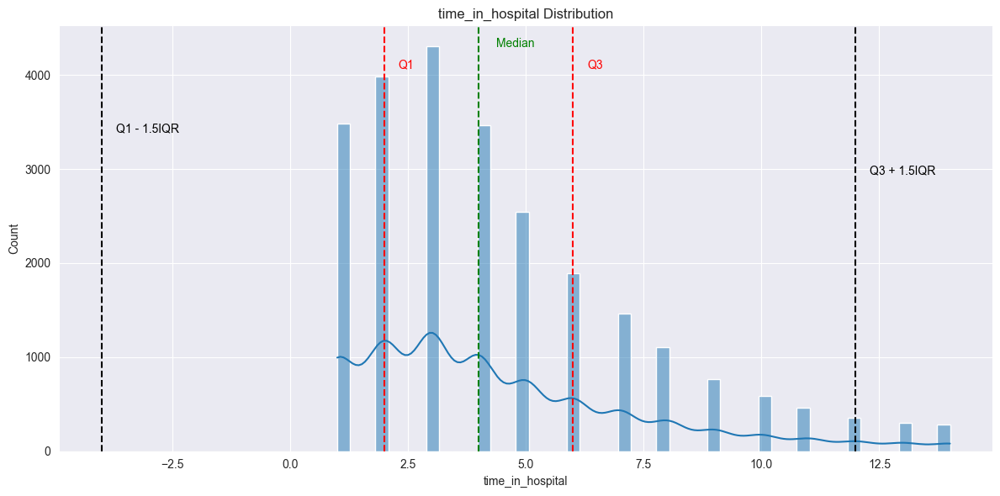

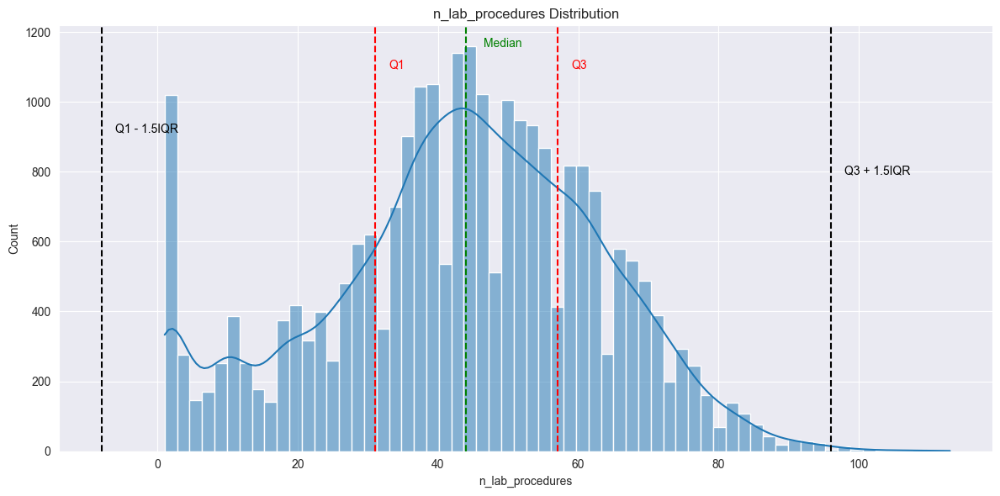

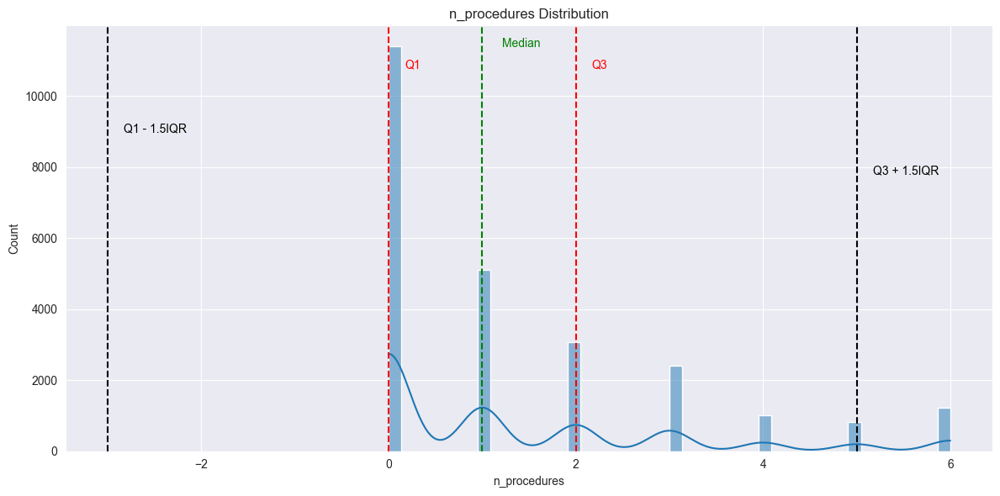

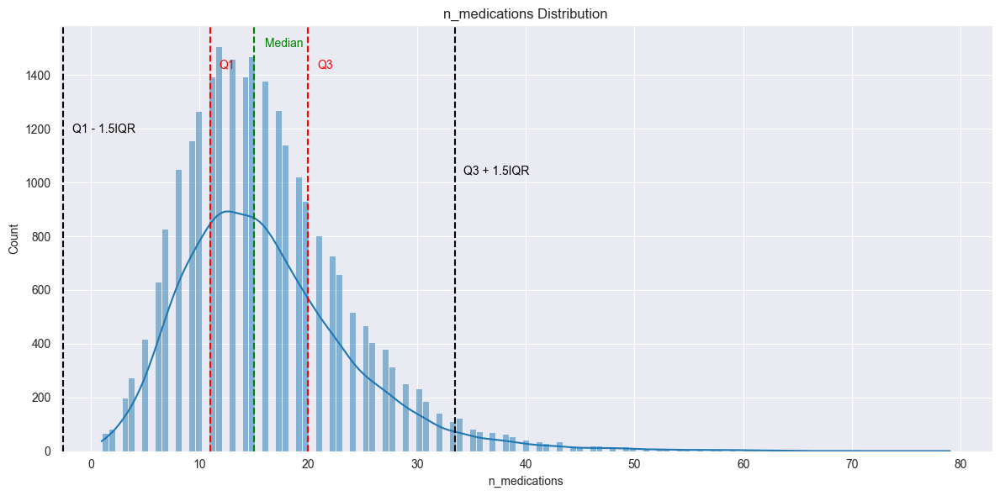

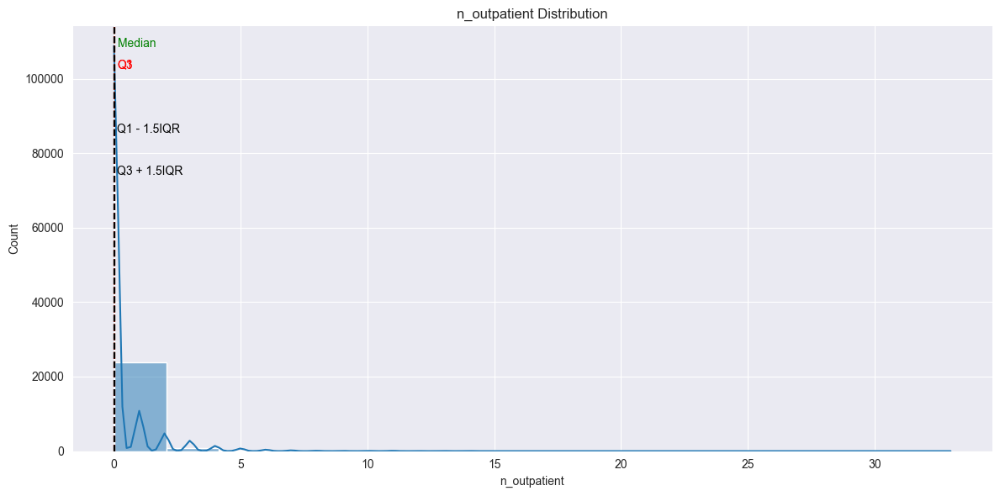

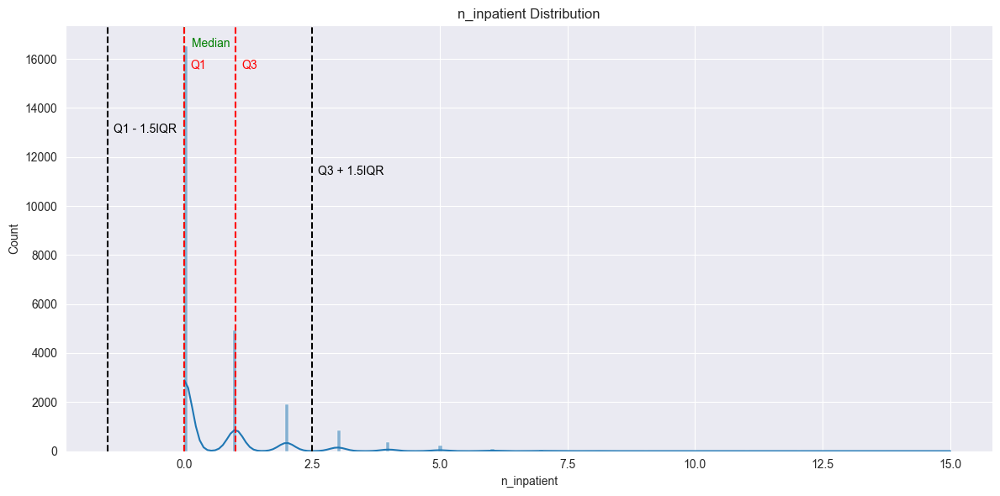

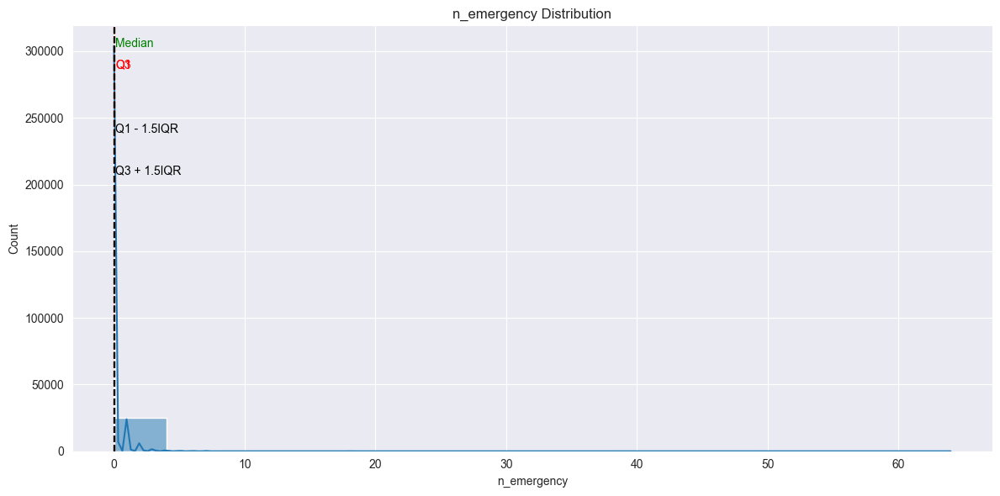

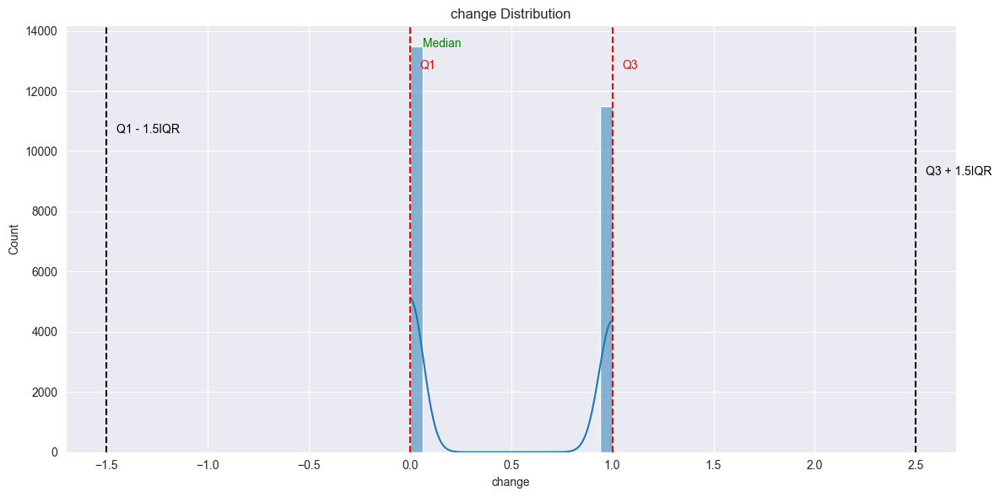

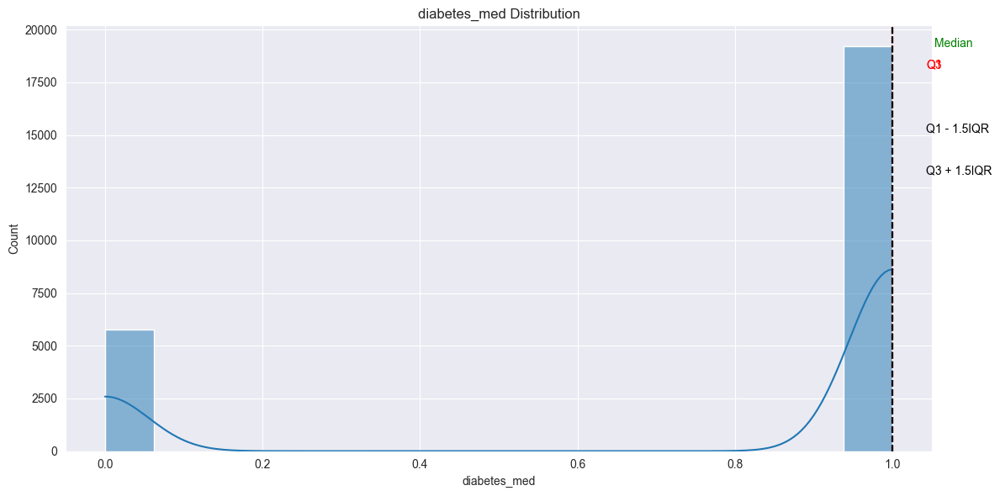

In [10]:
%matplotlib inline

def plot_distribution(df, method=None):    
    for col in df:

        fig, axes = plt.subplots(figsize=(12,6))
        plt.title(f"{col} Distribution")
        sns.histplot(data=df, x=col, kde=True)

        plt.axvline(df[col].median(), color='g', linestyle='dashed', linewidth=1.5)
        plt.text(x=df[col].median() + df[col].std()/8 , y=axes.get_ylim()[1] * 0.95, s='Median', fontsize=10, c='g')

        IQR = df[col].quantile(q=0.75) - df[col].quantile(q=0.25)

        plt.axvline(df[col].quantile(q=0.25), color='r', linestyle='dashed', linewidth=1.5)
        plt.text(x=df[col].quantile(q=0.25) + df[col].std()/10, y=axes.get_ylim()[1] * 0.90, s="Q1", fontsize=10, c='r')

        plt.axvline(df[col].quantile(q=0.25) - 1.5*IQR, color='k', linestyle='dashed', linewidth=1.5)
        plt.text(x=df[col].quantile(q=0.25) - 1.5*IQR + df[col].std()/10, y=axes.get_ylim()[1] * 0.75, s="Q1 - 1.5IQR", fontsize=10, c='k')
        
        plt.axvline(df[col].quantile(q=0.75), color='r', linestyle='dashed', linewidth=1.5)
        plt.text(x=df[col].quantile(q=0.75) + df[col].std()/10, y=axes.get_ylim()[1] * 0.90, s="Q3", fontsize=10, c='r')

        plt.axvline(df[col].quantile(q=0.75) + 1.5*IQR, color='k', linestyle='dashed', linewidth=1.5)
        plt.text(x=df[col].quantile(q=0.75) + 1.5*IQR + df[col].std()/10, y=axes.get_ylim()[1] * 0.65, s="Q3 + 1.5IQR", fontsize=10, c='k')
        
        if method != None:
            plt.suptitle(f"{method}")
        plt.tight_layout()
        plt.show()
        
plot_distribution(numerical_features)

* From the above analysis of the numerical features we can see that there's a significant amount of outliers and that most of the numerical features have high skewness. 
* Also, the variables **'n_emergency'**, **'n_outpatient'**, **'n_inpatient'** and **'n_procedures'** contain a lot of zeros, which will prevent us from using some of the Variance Stabilizing Transformation which can fix the high skewness. Also, during Feature Engineering, we may consider looking at imputation to see if we can achieve a more normal distribution. 

### Categorical features

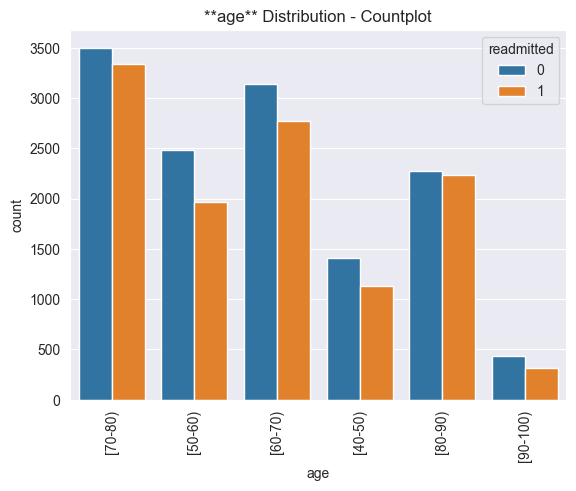

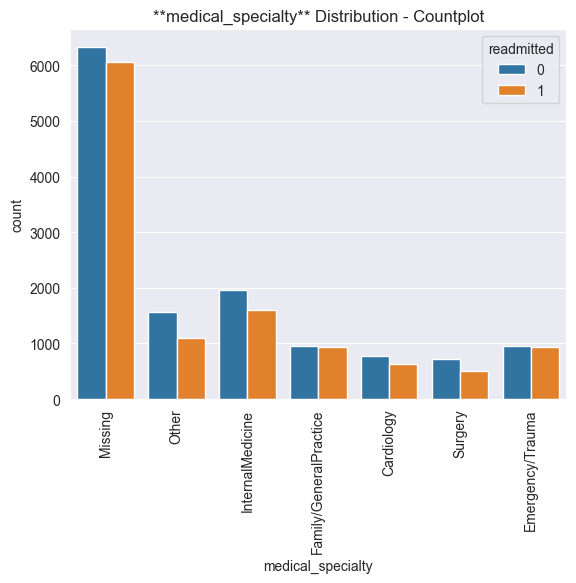

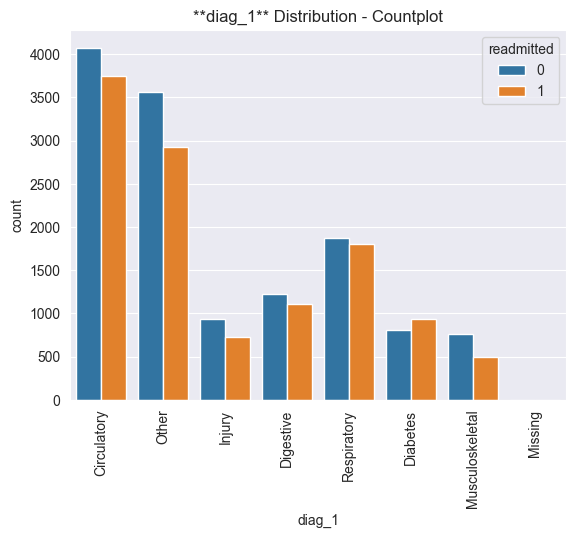

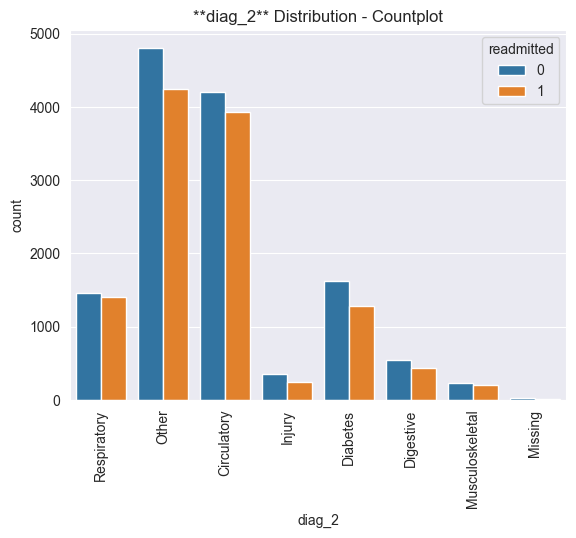

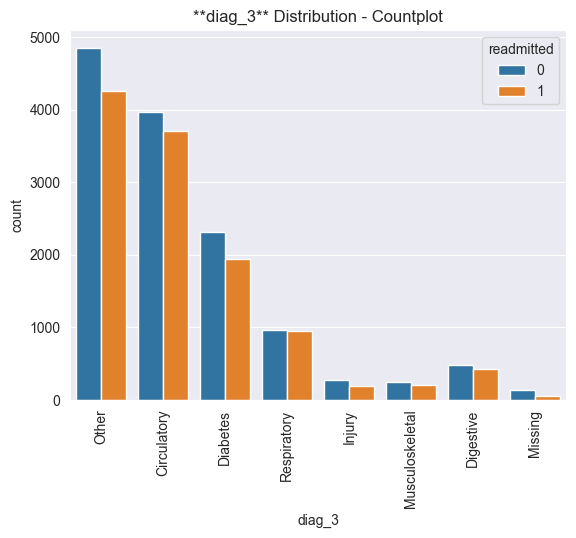

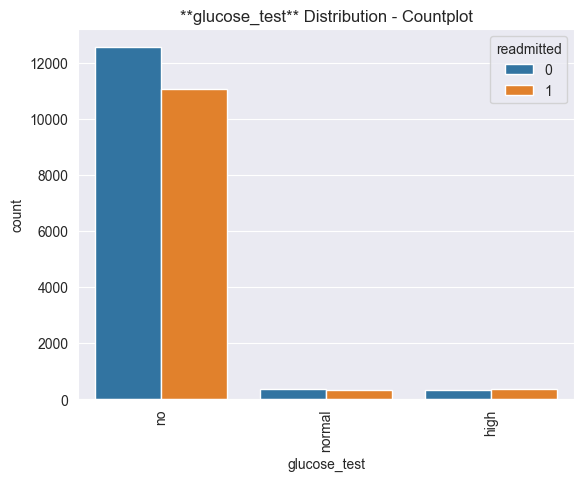

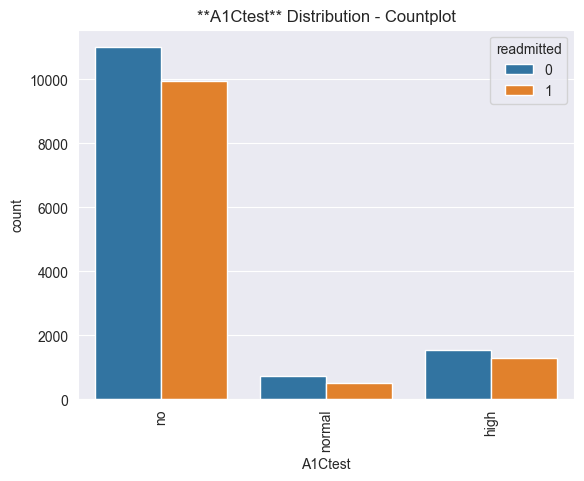

In [12]:
categorical_features = df.select_dtypes(include="object").columns.to_list()

for col in categorical_features:
    sns.countplot(data=df, x=col, hue=target_var)
    plt.title(f"**{col}** Distribution - Countplot")
    plt.xticks(rotation=90)
    plt.show()
    print("\n")

* From the plots above we can see that the target variable, **"readmitted"**, has fairly balanced distribution across the various categories for the categorical features.
* As we already noticed from the previous notebook, and we can better visualize it here, the variables **"medical_specialty"**, **"diag_1"**, **"diag_2"** and **"diag_3"** contain values labelled "missing". However, **"medical_specialty"** almost half of its values are labelled "missing" so it's a variable we can consider dropping.
* Also, we can see that the variables **"A1Ctest"** and **"glucose_test"** are imbalanced.
* For the variables **"age"**,**"diag_1"**, **"diag_2"**, **"diag_3"**, **"A1Ctest"** and **"glucose_test"**  we can consider using the **OrdinalEncoder()**.

## Correlation Study

First we will plot in a heat map the correlation, using the "pearson" and "spearman" methods, and Predictive Power Score. By performing PPS we can determine the level of thresholds to use for the heat map.  

In [13]:
def heatmap_corr(df, threshold, figsize=(20, 12), font_annot=8):
    if len(df.columns) > 1:
        mask = np.zeros_like(df, dtype=bool)
        mask[np.triu_indices_from(mask)] = True
        mask[abs(df) < threshold] = True

        fig, axes = plt.subplots(figsize=figsize)
        sns.heatmap(df, annot=True, xticklabels=True, yticklabels=True,
                    mask=mask, cmap='viridis', annot_kws={"size": font_annot}, ax=axes,
                    linewidth=0.5
                    )
        axes.set_yticklabels(df.columns, rotation=0)
        plt.ylim(len(df.columns), 0)
        plt.show()


def heatmap_pps(df, threshold, figsize=(20, 12), font_annot=8):
    if len(df.columns) > 1:
        mask = np.zeros_like(df, dtype=bool)
        mask[abs(df) < threshold] = True
        fig, ax = plt.subplots(figsize=figsize)
        ax = sns.heatmap(df, annot=True, xticklabels=True, yticklabels=True,
                        mask=mask, cmap='rocket_r', annot_kws={"size": font_annot},
                        linewidth=0.05, linecolor='grey')
        plt.ylim(len(df.columns), 0)
        plt.show()


def CalculateCorrAndPPS(df):
    df_corr_spearman = df.corr(method="spearman")
    df_corr_pearson = df.corr(method="pearson")

    pps_matrix_raw = pps.matrix(df)
    pps_matrix = pps_matrix_raw.filter(['x', 'y', 'ppscore']).pivot(columns='x', index='y', values='ppscore')

    pps_score_stats = pps_matrix_raw.query("ppscore < 1").filter(['ppscore']).describe().T
    print("PPS threshold - check PPS score IQR to decide threshold for heatmap \n")
    print(pps_score_stats.round(3))

    return df_corr_pearson, df_corr_spearman, pps_matrix


def DisplayCorrAndPPS(df_corr_pearson, df_corr_spearman, pps_matrix, CorrThreshold, PPS_Threshold,
                    figsize=(20, 12), font_annot=8):

    print("\n")
    print("* Analyse how the target variable for your ML models are correlated with other variables (features and target)")
    print("* Analyse multi-colinearity, that is, how the features are correlated among themselves")

    print("\n")
    print("*** Heatmap: Spearman Correlation ***")
    print("It evaluates monotonic relationship \n")
    heatmap_corr(df=df_corr_spearman, threshold=CorrThreshold, figsize=figsize, font_annot=font_annot)

    print("\n")
    print("*** Heatmap: Pearson Correlation ***")
    print("It evaluates the linear relationship between two continuous variables \n")
    heatmap_corr(df=df_corr_pearson, threshold=CorrThreshold, figsize=figsize, font_annot=font_annot)

    print("\n")
    print("*** Heatmap: Power Predictive Score (PPS) ***")
    print(f"PPS detects linear or non-linear relationships between two columns.\n"
        f"The score ranges from 0 (no predictive power) to 1 (perfect predictive power) \n")
    heatmap_pps(df=pps_matrix, threshold=PPS_Threshold, figsize=figsize, font_annot=font_annot)

In order to consider more correlations between the variables we will replace the values of the boolean categorical variables **"A1Ctest"** and **"glucose_test"** and transformer them to numerical.

In [14]:
vars_to_replace = ['A1Ctest','glucose_test']

for var in vars_to_replace:
    print(var)
    print(df[var].unique())

for var in vars_to_replace:
    df[var].replace(to_replace={'no': 0, 'normal': 1, 'high':2}, inplace=True)

df.head()

A1Ctest
['no' 'normal' 'high']
glucose_test
['no' 'normal' 'high']


,age,time_in_hospital,n_lab_procedures,n_procedures,n_medications,n_outpatient,n_inpatient,n_emergency,medical_specialty,diag_1,diag_2,diag_3,glucose_test,A1Ctest,change,diabetes_med,readmitted
0,[70-80),8,72,1,18,2,0,0,Missing,Circulatory,Respiratory,Other,0,0,0,1,0
1,[70-80),3,34,2,13,0,0,0,Other,Other,Other,Other,0,0,0,1,0
2,[50-60),5,45,0,18,0,0,0,Missing,Circulatory,Circulatory,Circulatory,0,0,1,1,1
3,[70-80),2,36,0,12,1,0,0,Missing,Circulatory,Other,Diabetes,0,0,1,1,1
4,[60-70),1,42,0,7,0,0,0,InternalMedicine,Other,Circulatory,Respiratory,0,0,0,1,0


In [15]:
df_corr_pearson, df_corr_spearman, pps_matrix = CalculateCorrAndPPS(df)

PPS threshold - check PPS score IQR to decide threshold for heatmap 

         count   mean    std  min  25%  50%  75%    max
ppscore  272.0  0.006  0.022  0.0  0.0  0.0  0.0  0.187


From the PPS levels above we see that our features don't have strong predictive power, since the max value is     0.187, so we don't expect strong correlations either. Thus, we will consider using a PPS Threshold equal to the **mean** and CorrThreshold equal to 0.2, which will show all the weak correlations as well.



* Analyse how the target variable for your ML models are correlated with other variables (features and target)
* Analyse multi-colinearity, that is, how the features are correlated among themselves


*** Heatmap: Spearman Correlation ***
It evaluates monotonic relationship 



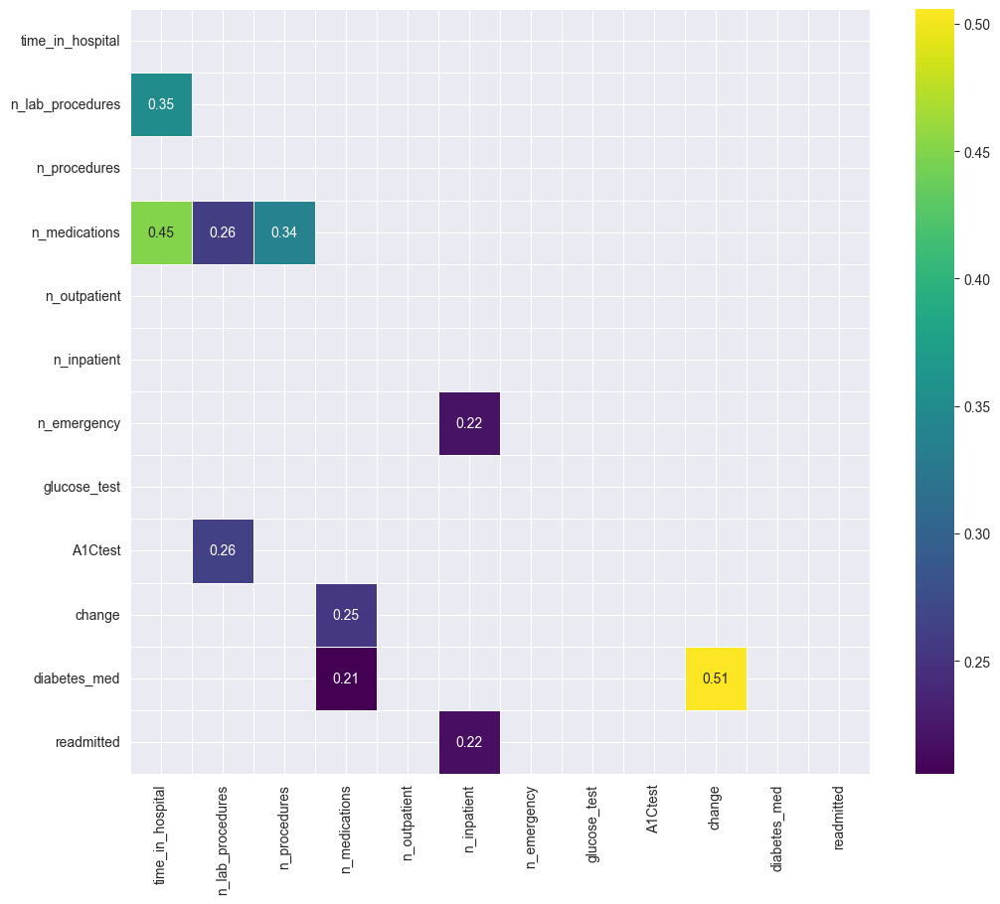



*** Heatmap: Pearson Correlation ***
It evaluates the linear relationship between two continuous variables 



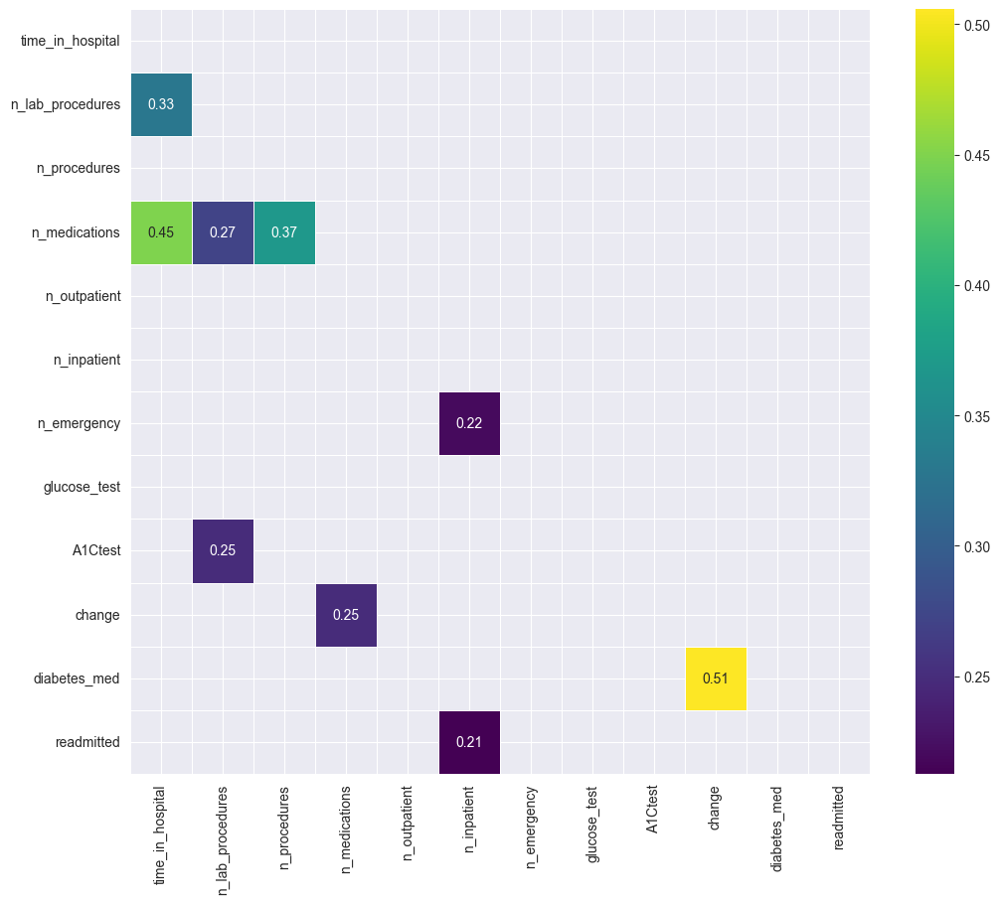



*** Heatmap: Power Predictive Score (PPS) ***
PPS detects linear or non-linear relationships between two columns.
The score ranges from 0 (no predictive power) to 1 (perfect predictive power) 



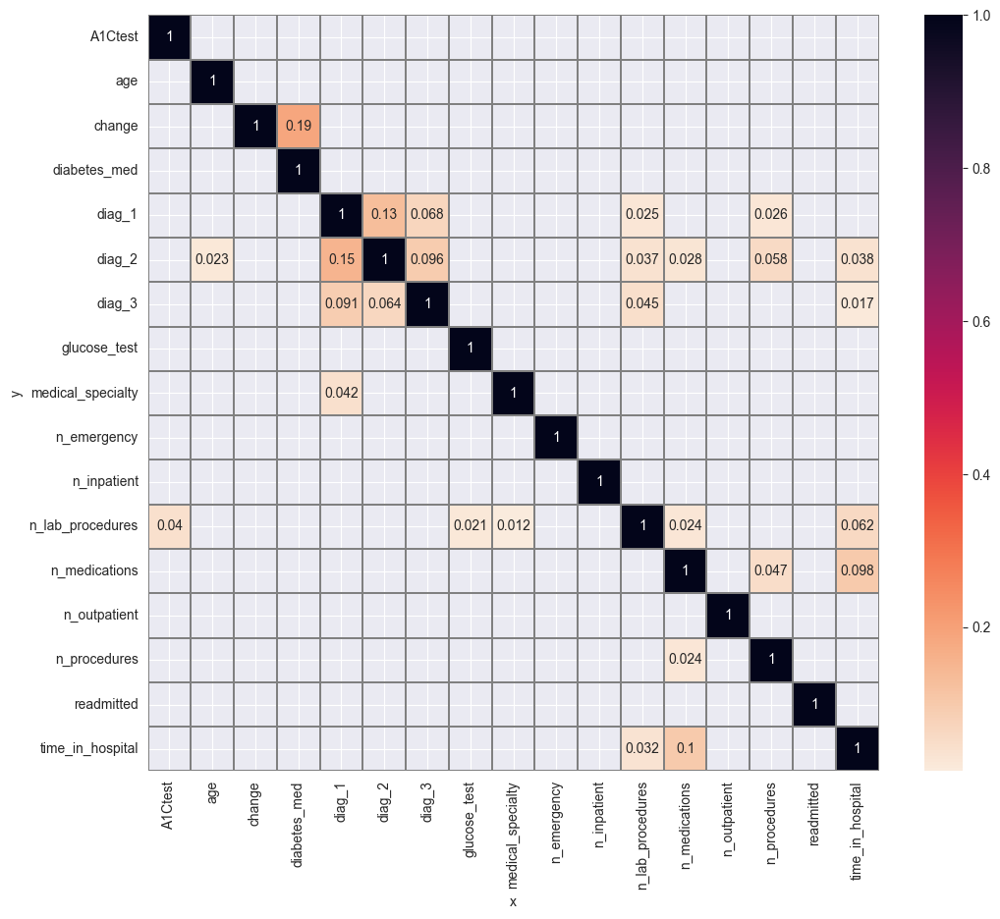

In [16]:
DisplayCorrAndPPS(df_corr_pearson = df_corr_pearson,
                df_corr_spearman = df_corr_spearman, 
                pps_matrix = pps_matrix,
                CorrThreshold = 0.2, PPS_Threshold =0.006,
                figsize=(12,10), font_annot=10)

As expected, our target variable showed weak correlation with only one feature, in both methods, and showed no predictive power.

In order to find better correlations, which will better help us answer the Business Requirement 1 and help us later with our modeling, we will try to unskew the data. A good way to do this, is by using the Log Transformation, which according to its documentation is used to transform skewed data so that the values are more evenly distributed across the value range. 

We, also, know that some of our variables contain a lot of zeros, and the Log Transformer can only be applied to positive values. For that, according to the user guide of the Log Transformer, to transform non-positive variables we can add a constant to shift the data points towards positive values. 

##### **Step 1**

* Create a dataframe with all the numerical variables and plot them using **FacetGrid()** from seaborn before we processes them.

In [17]:
numericCols = df.select_dtypes(include=[int,float]).columns

df_numeric_features = df[numericCols]
print(df_numeric_features.shape)
df_numeric_features.head()

(25000, 12)


,time_in_hospital,n_lab_procedures,n_procedures,n_medications,n_outpatient,n_inpatient,n_emergency,glucose_test,A1Ctest,change,diabetes_med,readmitted
0,8,72,1,18,2,0,0,0,0,0,1,0
1,3,34,2,13,0,0,0,0,0,0,1,0
2,5,45,0,18,0,0,0,0,0,1,1,1
3,2,36,0,12,1,0,0,0,0,1,1,1
4,1,42,0,7,0,0,0,0,0,0,1,0


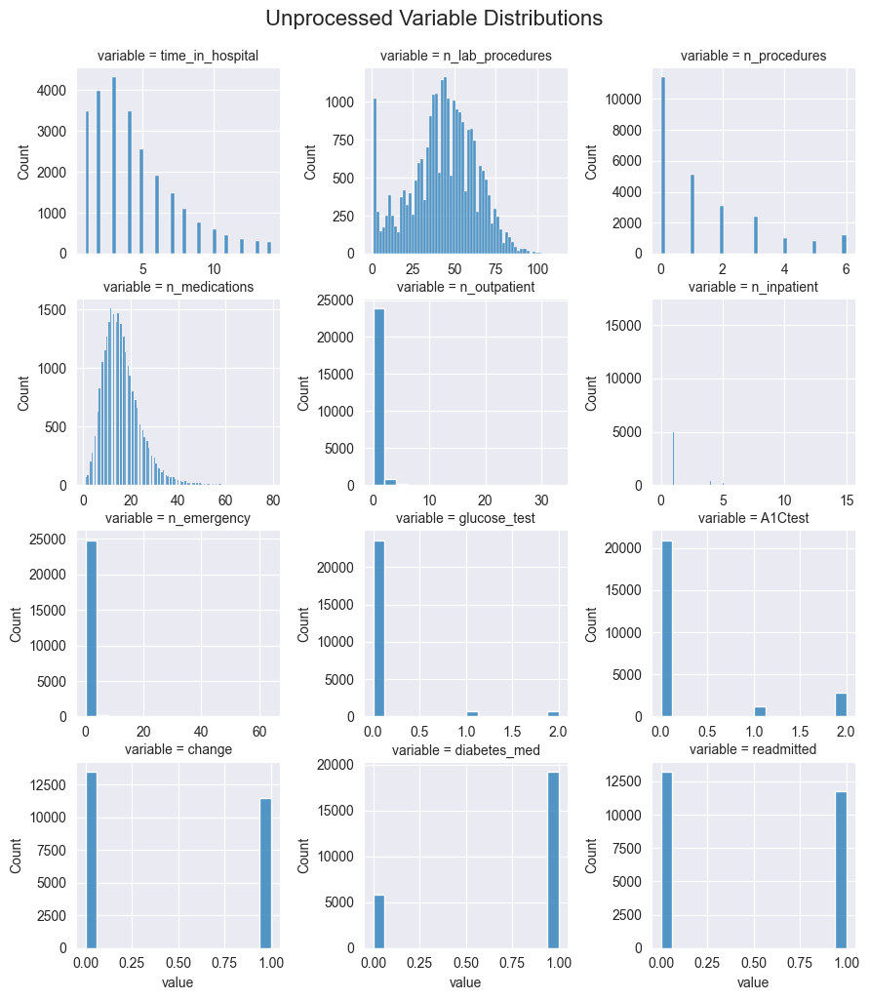

In [19]:
# Plot the distributions of the selected variables before we processes them
g = sns.FacetGrid(
    df_numeric_features.melt(),  
    col='variable',  
    sharey=False,  
    sharex=False,  
    col_wrap = 3
)

g.map(sns.histplot, "value")
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle("Unprocessed Variable Distributions", fontsize=16,y=.85)
plt.show()

##### **Step 2**

* Select the columns to transform and then add 1 to all of them and apply the Log Transformer using **np.log()**

In [20]:
transformCols = ['time_in_hospital','n_lab_procedures','n_procedures',
                'n_medications','n_outpatient','n_inpatient','n_emergency']
all([pd.api.types.is_numeric_dtype(df_numeric_features[col]) for col in transformCols])

True

In [21]:
df_log = df_numeric_features.copy()
# Perform a log transformation of the data to unskew the data
for feat in transformCols:
    #Add one to avoid INF values
    df_log[feat] = np.log(1+df_numeric_features[feat])

df_log.head()

,time_in_hospital,n_lab_procedures,n_procedures,n_medications,n_outpatient,n_inpatient,n_emergency,glucose_test,A1Ctest,change,diabetes_med,readmitted
0,2.197225,4.290459,0.693147,2.944439,1.098612,0.0,0.0,0,0,0,1,0
1,1.386294,3.555348,1.098612,2.639057,0.000000,0.0,0.0,0,0,0,1,0
2,1.791759,3.828641,0.000000,2.944439,0.000000,0.0,0.0,0,0,1,1,1
3,1.098612,3.610918,0.000000,2.564949,0.693147,0.0,0.0,0,0,1,1,1
4,0.693147,3.761200,0.000000,2.079442,0.000000,0.0,0.0,0,0,0,1,0


##### **Step 3**

* We will apply the StandardScaler transformation to scale the data and make the variance across features uniform, and also apply PCA to help retain most of the variance with fewer features.

In [22]:
# Instantiate StandardScaler, PCA as scaler and pca respectively
scaler = StandardScaler()
pca = PCA()
# Create the pipeline using scaler and the pca object
pipeline = make_pipeline(scaler, pca)

# Fit and transform the model
df_normalized = pipeline.fit_transform(df_log)
df_normalized.shape

(25000, 12)

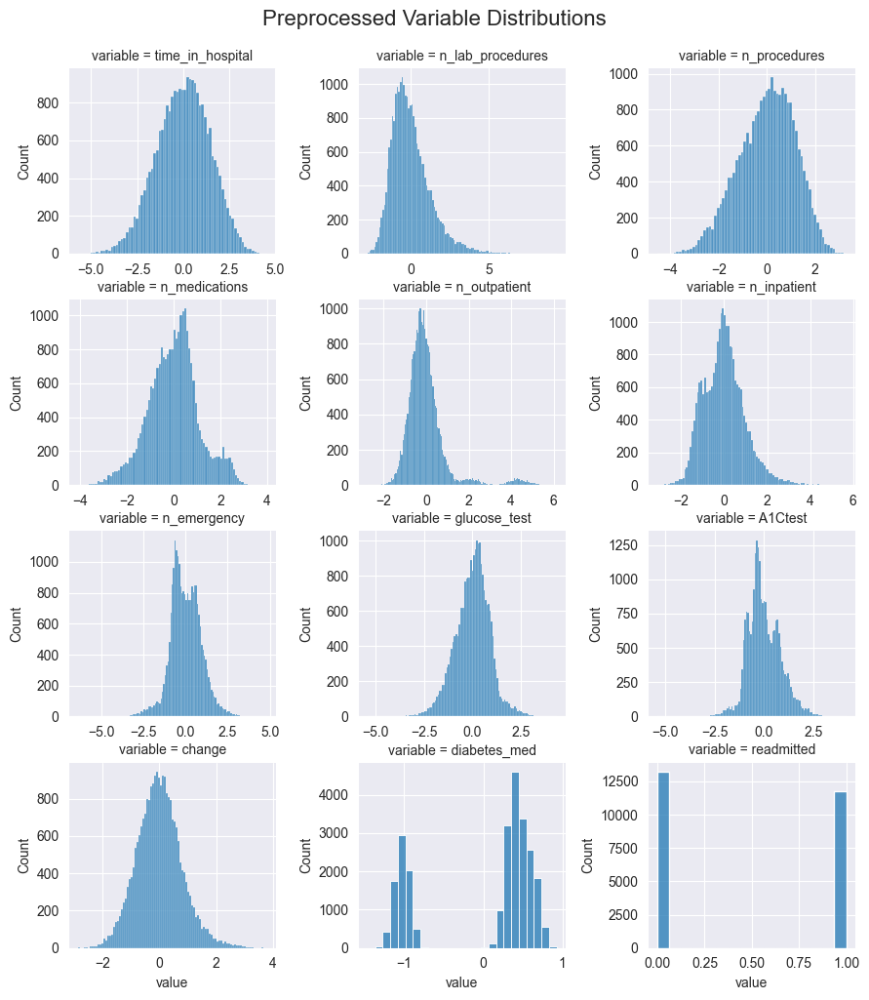

In [23]:
# Create a dataFrame of the processed data
df_processed = pd.DataFrame(
    data=df_normalized, index=df_log.index, columns=df_log.columns
)

df_processed['readmitted'] = df_numeric_features['readmitted']

# Plot the distributions of the selected variables after processing them
g = sns.FacetGrid(df_processed.melt(), 
                col="variable", 
                col_wrap = 3, 
                sharey=False, 
                sharex=False
                )
g.map(sns.histplot, "value")
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle("Preprocessed Variable Distributions", fontsize=16,y=.85)
plt.show()

From the plot above, we can see that it worked pretty well, so we can now calculate again the correlation levels and the PPS.

In [24]:
df_corr_pearson, df_corr_spearman, pps_matrix = CalculateCorrAndPPS(df_processed)

PPS threshold - check PPS score IQR to decide threshold for heatmap 

         count   mean    std  min  25%  50%  75%    max
ppscore  132.0  0.016  0.061  0.0  0.0  0.0  0.0  0.435




* Analyse how the target variable for your ML models are correlated with other variables (features and target)
* Analyse multi-colinearity, that is, how the features are correlated among themselves


*** Heatmap: Spearman Correlation ***
It evaluates monotonic relationship 



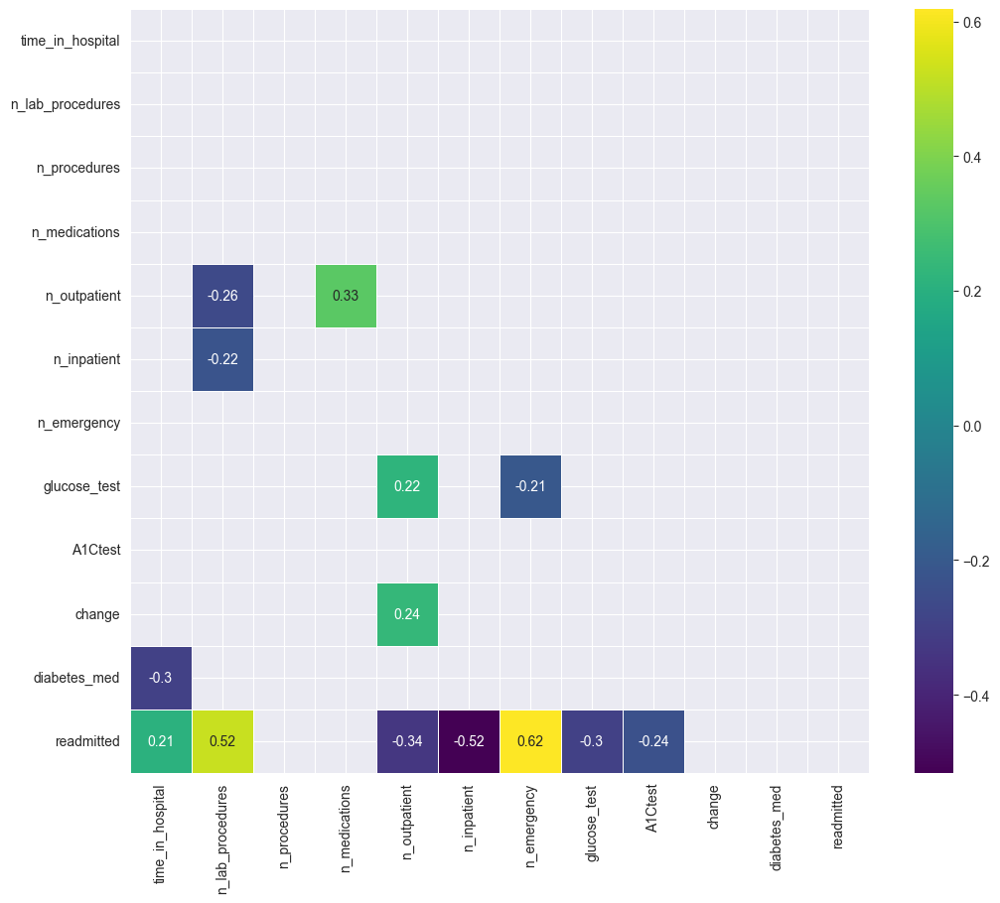



*** Heatmap: Pearson Correlation ***
It evaluates the linear relationship between two continuous variables 



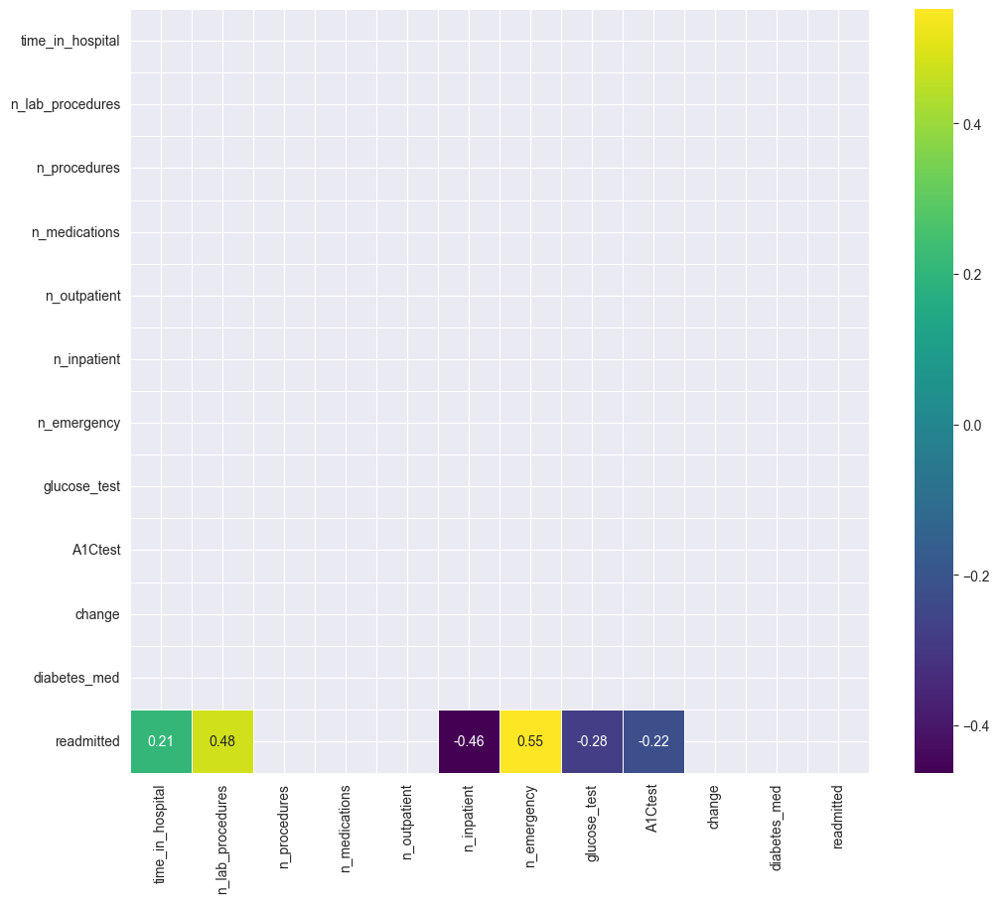



*** Heatmap: Power Predictive Score (PPS) ***
PPS detects linear or non-linear relationships between two columns.
The score ranges from 0 (no predictive power) to 1 (perfect predictive power) 



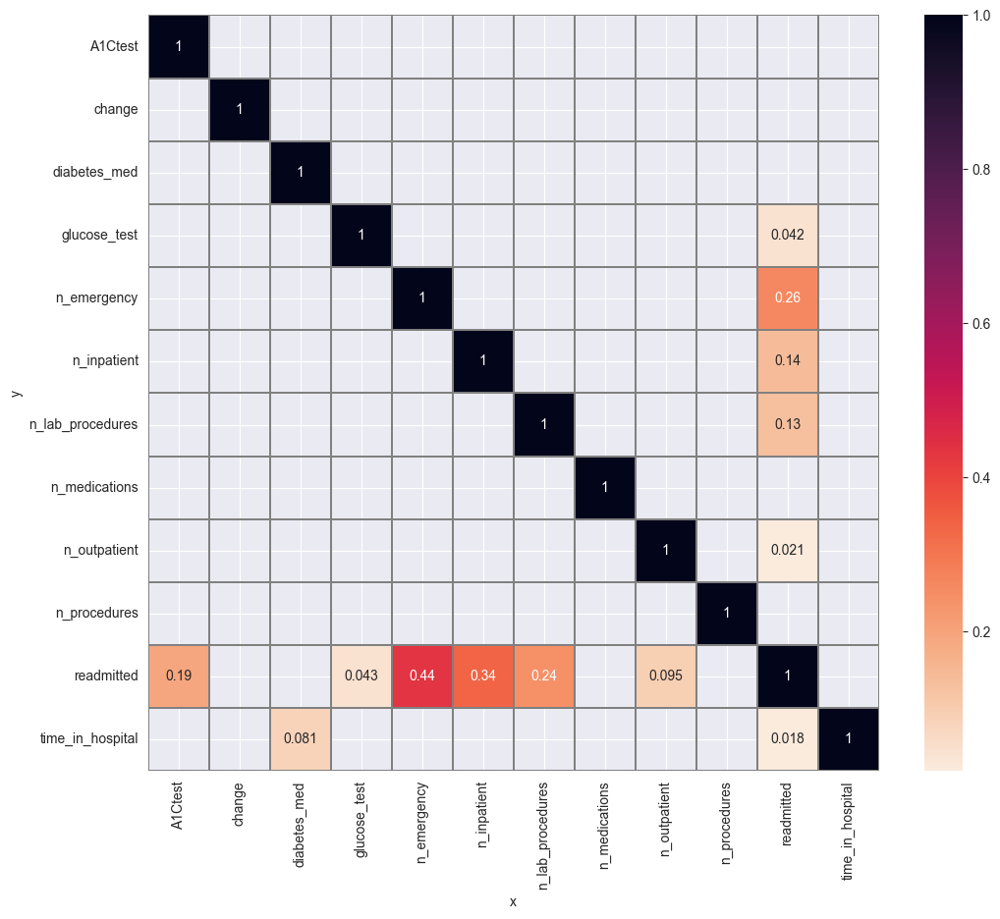

In [26]:
DisplayCorrAndPPS(df_corr_pearson = df_corr_pearson,
                df_corr_spearman = df_corr_spearman, 
                pps_matrix = pps_matrix,
                CorrThreshold = 0.2, PPS_Threshold =0.016, # same as the mean
                figsize=(12,10), font_annot=10)

In [27]:
corr_spearman = df_processed.corr(method="spearman")["readmitted"].sort_values(ascending=False, key=abs)[1:].head(10)
corr_spearman

n_emergency         0.618487
n_lab_procedures    0.523029
n_inpatient        -0.516249
n_outpatient       -0.338235
glucose_test       -0.295939
A1Ctest            -0.236427
time_in_hospital    0.207055
n_medications       0.167568
n_procedures       -0.123269
diabetes_med        0.084762
Name: readmitted, dtype: float64

In [28]:
corr_pearson = df_processed.corr(method="pearson")["readmitted"].sort_values(ascending=False, key=abs)[1:].head(10)
corr_pearson

n_emergency         0.552237
n_lab_procedures    0.477780
n_inpatient        -0.463656
glucose_test       -0.278837
A1Ctest            -0.217945
time_in_hospital    0.207361
n_outpatient       -0.195622
n_medications       0.159034
n_procedures       -0.130918
change              0.048361
Name: readmitted, dtype: float64

In [30]:
top_n = 5
most_correlated_features = set(corr_spearman[:top_n].index.to_list() + corr_pearson[:top_n].index.to_list())
most_correlated_features

{'A1Ctest',
 'glucose_test',
 'n_emergency',
 'n_inpatient',
 'n_lab_procedures',
 'n_outpatient'}

To further understand the factors that might contribute towards patient's readmission, we will plot the most correlate features into graphs, colored by the target variable.

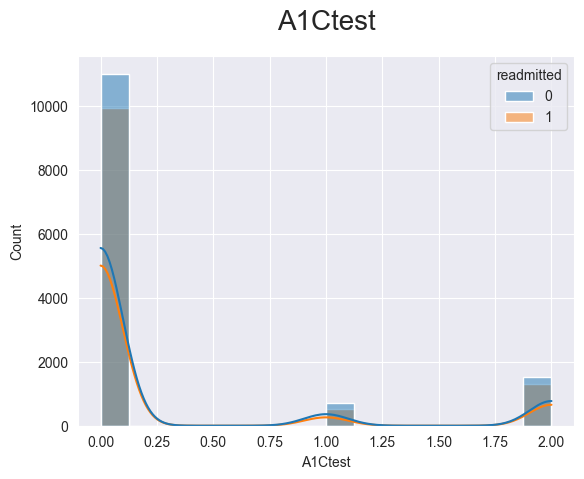

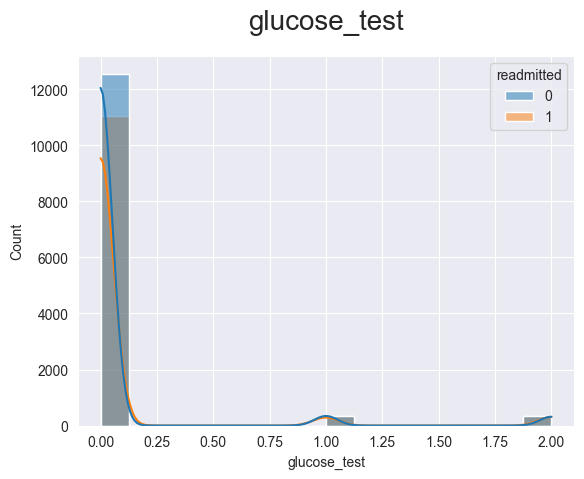

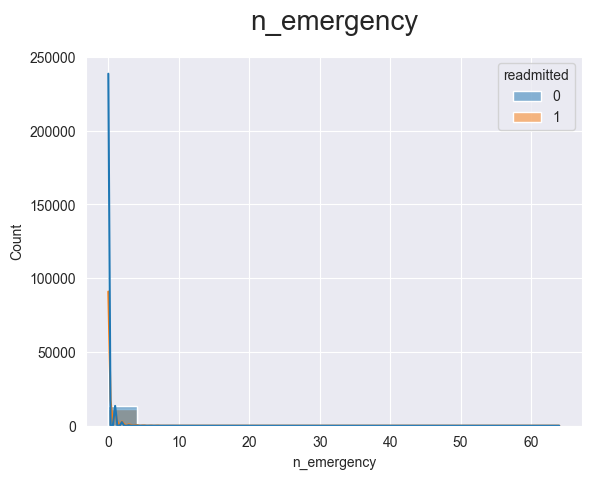

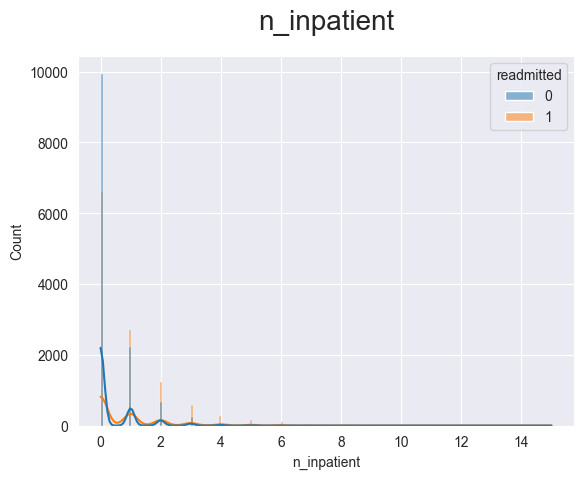

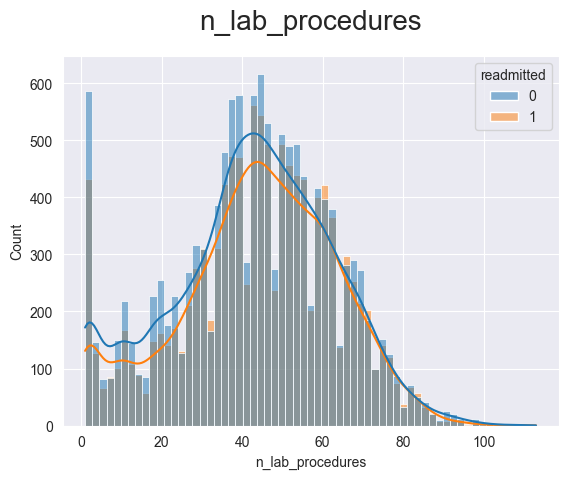

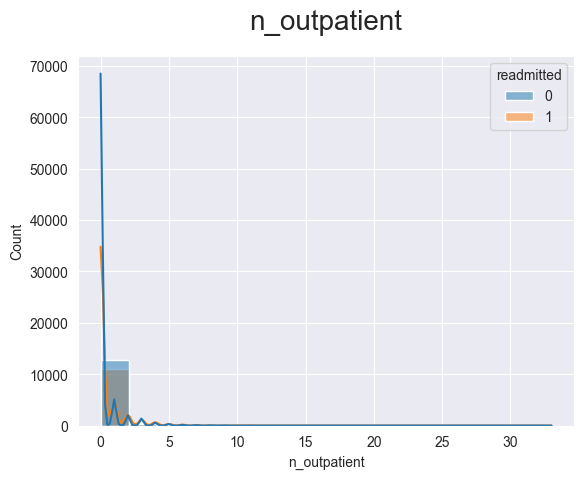

In [31]:
features_to_plot = ['A1Ctest',
                    'glucose_test',
                    'n_emergency',
                    'n_inpatient',
                    'n_lab_procedures',
                    'n_outpatient'
                    ]

def plot_categorical(df, col):
    sns.countplot(df, x=col, hue=target_var)
    plt.title(f"{col}", fontsize=20, y=1.05)
    plt.show()

def plot_numerical(df, col):
    sns.histplot(df, x=col, kde=True, hue=target_var)
    plt.title(f"{col}", fontsize=20, y=1.05)
    plt.show()

for feature in features_to_plot:
    if df[feature].dtype == "object":
        plot_categorical(df, feature)
    else:
        plot_numerical(df, feature)

Below, to better visualize the patterns, we plot the above features to a parallel_categories() plot.

In [33]:
# create a dataframe with the most correlated features
df_parallel = df.filter(features_to_plot)
df_parallel['readmitted'] = df[target_var]
df_parallel.head()

,A1Ctest,glucose_test,n_emergency,n_inpatient,n_lab_procedures,n_outpatient,readmitted
0,0,0,0,0,72,2,0
1,0,0,0,0,34,0,0
2,0,0,0,0,45,0,1
3,0,0,0,0,36,1,1
4,0,0,0,0,42,0,0


To better plot the **parallel_categories()** function and avoid clutter, we are going to create bins to categorize and better understand the values of the variables **"n_emergency"**, **"n_inpatient"**, **"n_outpatient"** and **"n_lab_procedures"**. 

In [34]:
bins = pd.cut(df_parallel['n_emergency'], bins = [-0.001, 0, 1, 10, 100],
                labels=['None', 'One','Up to 10','Above 10'])
df_parallel['n_emergency_bins'] = bins

bins = pd.cut(df_parallel['n_outpatient'], bins = [-0.001, 0, 1, 10, 35],
                labels=['None', 'One','Up to 10','Up to 25'])
df_parallel['n_outpatient_bins'] = bins

bins = pd.cut(df_parallel['n_inpatient'], bins = [-0.001, 0, 1, 5, 10, 15],
                labels=['None', 'One','Up to 5','Up to 10','Above 10'])
df_parallel['n_inpatient_bins'] = bins

bins = pd.cut(df_parallel['n_lab_procedures'], bins=[-0.001, 10,50,100,120],
                        labels=['up to 10', '11-50', '51-100', 'above 100'])
df_parallel['n_lab_procedures_bins'] = bins

df_parallel.drop(['n_emergency','n_outpatient','n_inpatient', 'n_lab_procedures'], axis=1, inplace=True)
df_parallel = df_parallel[[col for col in df_parallel.columns if col != 'readmitted'] + ['readmitted']]
df_parallel.head()

,A1Ctest,glucose_test,n_emergency_bins,n_outpatient_bins,n_inpatient_bins,n_lab_procedures_bins,readmitted
0,0,0,None,Up to 10,None,51-100,0
1,0,0,None,None,None,11-50,0
2,0,0,None,None,None,11-50,1
3,0,0,None,One,None,11-50,1
4,0,0,None,None,None,11-50,0


In [35]:
fig = px.parallel_categories(df_parallel, color=target_var)
fig.show()

From the above correlation study and and by plotting the most correlated features we notice a pattern for the readmitted patients.

* A readmitted patient typically has no A1Ctest.
* A readmitted patient typically has no glucose test.
* A readmitted patient typically has no emergency visit.
* A readmitted patient typically has no outpatient visit.
* A readmitted patient typically has between no inpatient visits and 5 inpatient visits.
* A readmitted patient typically has high number of lab procedures.

## Hypothesis validation

#### *Hypothesis 1*

*'Patients with a higher number of lab procedures are more likely to be readmitted.'* 

In [36]:
*_procedures_bins','readmitted']].value_counts(normalize=True).mul(100).round(2).astype(str) + '%'

n_lab_procedures_bins  readmitted
11-50                  0             29.22%
                       1              25.3%
51-100                 0             19.02%
                       1             18.07%
up to 10               0               4.7%
                       1              3.62%
above 100              0              0.04%
                       1              0.02%
dtype: object

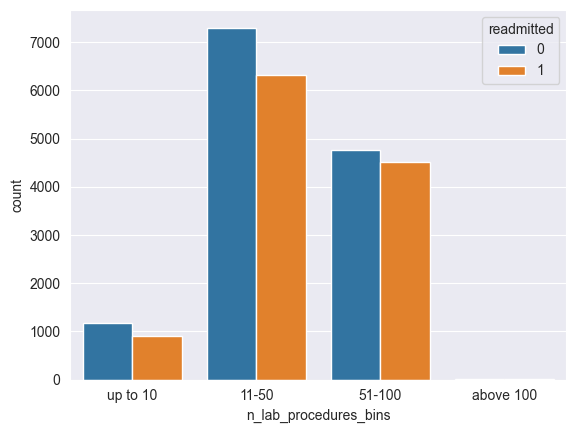

In [37]:
sns.countplot(df_parallel, x=df_parallel['n_lab_procedures_bins'], hue=df_parallel['readmitted'])
plt.show()

In [11]:
from scipy.stats import ttest_ind, chi2_contingency, pearsonr
import numpy as np

# Hypothesis 1: Correlation between number of lab procedures and readmission
# Pearson correlation test between n_lab_procedures and readmitted
correlation, p_value_correlation = pearsonr(df['n_lab_procedures'], df['readmitted'])

# Hypothesis 1: T-test to compare average lab procedures between readmitted and non-readmitted patients
readmitted_lab_procedures = df[df['readmitted'] == 1]['n_lab_procedures']
non_readmitted_lab_procedures = df[df['readmitted'] == 0]['n_lab_procedures']

t_stat_lab_procedures, p_value_lab_procedures = ttest_ind(readmitted_lab_procedures, non_readmitted_lab_procedures)

# Results

print(f"Hypothesis 1 - Correlation: {correlation}, {p_value_correlation}")
print(f"Hypothesis 1 - T-test: {t_stat_lab_procedures}, {p_value_lab_procedures}")

Hypothesis 1 - Correlation: 0.0329703223189839, 1.845898010286585e-07
Hypothesis 1 - T-test: 5.215692768862603, 1.8458980102858898e-07


* There is a very weak positive correlation between the number of lab procedures and readmission, but it is statistically significant due to the low p-value.
* There is a very weak positive correlation between the number of lab procedures and readmission, but it is statistically significant due to the low p-value.

**Conclusion**: Hypothesis 1 is supported by the data, as there is a statistically significant but weak relationship between the number of lab procedures and the likelihood of readmission.

#### *Hypothesis 2*

*'Patients who had a change in their diabetes medication during their hospital stay are more likely to be readmitted.'*

In [38]:
df[['change','readmitted', 'diabetes_med']].value_counts(normalize=True).mul(100).round(2).astype(str) + '%'

change  readmitted  diabetes_med
1       0           1                23.3%
        1           1               22.71%
0       0           1               16.14%
        1           1               14.76%
        0           0               13.54%
        1           0                9.55%
dtype: object

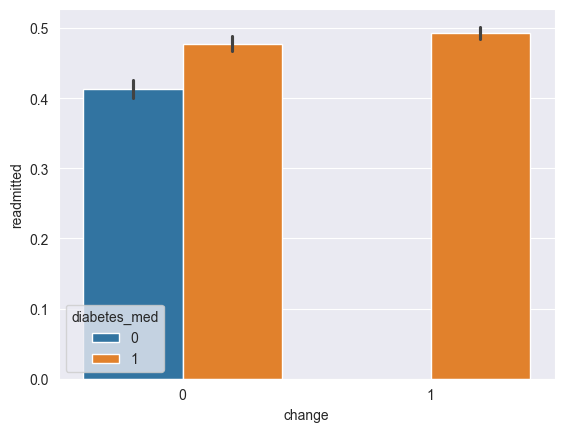

In [39]:
sns.barplot(df, x='change', y='readmitted', hue='diabetes_med')
plt.show()

In [12]:
# Hypothesis 2: Chi-Square test between change in diabetes medication and readmission
contingency_table = pd.crosstab(df['change'], df['readmitted'])
chi2, p_value_chi2, _, _ = chi2_contingency(contingency_table)

# Results
print(f"Hypothesis 2 - Chi-Square Test: {chi2}, {p_value_chi2}")

Hypothesis 2 - Chi-Square Test: 46.51351158916284, 9.098887998980001e-12


There is a significant association between a change in diabetes medication and readmission.

**Conclusion**: Hypothesis 2 is strongly supported by the data, indicating that patients who had a change in their diabetes medication are indeed more likely to be readmitted.

#### *Hypothesis 3*

*'Patients of higher age have a higher probability of readmission. '*

In [40]:
df[['age']].value_counts(normalize=True).mul(100).round(2).astype(str) + '%'

age     
[70-80)     27.35%
[60-70)     23.65%
[80-90)     18.06%
[50-60)     17.81%
[40-50)     10.13%
[90-100)      3.0%
dtype: object

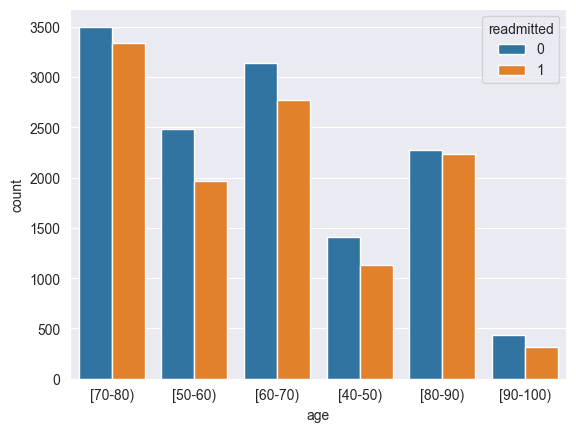

In [41]:
sns.countplot(df, x=df['age'], hue=df_parallel['readmitted'])
plt.show()

In [14]:
def categorize_age(age):
    if age in ['[0-10)', '[10-20)', '[20-30)', '[30-40)', '[40-50)', '[50-60)']:
        return 'Under 60'
    elif age in ['[60-70)', '[70-80)']:
        return '60-80'
    elif age in ['[80-90)', '[90-100)']:
        return 'Over 80'
    else:
        return 'Unknown'  # For any unexpected values

# Apply the function to create a new column with categorized age groups
df_age_group = df.filter('age')
df_age_group['age_group'] = df['age'].apply(categorize_age)

df_age_group['age_group'].value_counts(normalize=True).mul(100).round(2).astype(str) + '%'

60-80        51.0%
Under 60    27.94%
Over 80     21.06%
Name: age_group, dtype: object

In [15]:
contingency_table_age = pd.crosstab(df_age_group['age_group'], df['readmitted'])
chi2_age, p_value_age, _, _ = chi2_contingency(contingency_table_age)

# Results
print(f"Chi-Square Statistic: {chi2_age}")
print(f"P-Value: {p_value_age}")

Chi-Square Statistic: 29.565992306954563
P-Value: 3.8003740552540217e-07


The very low p-value indicates a statistically significant association between age group and readmission. This suggests that patients of higher age groups are more likely to be readmitted, supporting Hypothesis 3.

**Conclusion**: Hypothesis 3 is valid based on the data, indicating that higher age groups have a higher probability of readmission. ​

# Push files to Repo

* In case you don't need to push files to Repo, you may replace this section with "Conclusions and Next Steps" and state your conclusions and next steps.

In [ ]:
df_parallel.to_csv("outputs/datasets/collection/HospitalReadmissionsParallel.csv", index=False)

In [ ]:
df_processed.to_csv("outputs/datasets/collection/HospitalReadmissionsCorrelation.csv", index=False)

In [16]:
df_age_group.to_csv("outputs/datasets/collection/HospitalReadmissionsAgeGroups.csv", index=False)

---

## Conclusions

 From the EDA we performed above we noticed the following: 
 
 - That the features had very weak to weak correlation with the target variable and also the PPScore doesn't show any predictive power. After applying the Logarithmic Transformation to unskew the data and reduce variability, StandardScaler to make the variance across the features uniform and PCA to retain most of the variance with fewer features we were able to find moderate correlation and strong PPS between the features and the target variable.
 - The numerical variables have many outliers, high skewness and variance, but our approach to unskew and reduce variability of the data had a positive impact and is something to consider for the Feature Engineering and Modeling stage. 
 - The categorical features don't appear to have any significant imbalance and also they don't show any missing values, except the variables "medical_specialty", "diag_1", "diag_2" and "diag_3", which have some of their values labelled "Missing". 

Lastly, after performing a correlation study we were able to identify an initial possible pattern contributing to readmissions and also we made a visual and statistical analysis of our hypothesis to see if their are validated or not.

## Next Steps

In the next notebook we will begin the Data Cleaning based on the EDA we performed here.

This will take us to the 'Data Preparation' of thr CRISP-DM workflow.